In [1]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb

In [2]:
# Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7, 0.8, 20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list("my_colormap", colorsComb)

In [3]:
# mpl.use("module://ipykernel.pylab.backend_inline")
sc.logging.print_header()
sc.set_figure_params(facecolor="white", figsize=(4, 4),fontsize=16, dpi_save=300, dpi=100)
sc.settings.verbosity = 3

/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.8.1 pandas==1.4.2 scikit-learn==1.1.1 statsmodels==0.13.2 python-igraph==0.9.10 pynndescent==0.5.7


## Saving data dir

In [4]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/' 
#this is my file path please adapt it to your directory

The data directory contains all processed data and `anndata` files. 

In [5]:
data_dir = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Visium/080822/data/'

The tables directory contains all tabular data output, e.g. in `.csv` or `.xls` file format. That applies to differential expression test results or overview tables such as the number of cells per cell type.

In [7]:
table_dir = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/figures/visium/'

The default figure path is a POSIX path calles 'figures'. If you don't change the default figure directory, scanpy creates a subdirectory where this notebook is located.  

In [8]:
sc.settings.figdir =  '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/figures/visium/'

**Comment:** When you repeat certain analyses, it might be helpful to set a date variable and add it to every figure and table (see `datetime` Python package).

In [9]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

# Reading data

In [10]:
adata=sc.read(data_dir+"220808adata_spatial_intact_3dpi_V_paper.h5ad")

In [11]:
type(adata.var_names)

pandas.core.indexes.base.Index

In [26]:
DAMPs_genes=['Hmgb1', 'S100a4', 'S100a8', 'S100a9','S100a11','Hspbp1',
                         'Lgals1', 'Lgals3', 'Lgals9', 'Bgn', 'Fn1']

In [23]:
sc.tl.score_genes(adata, ['Hmgb1', 'S100a4', 'S100a8', 'S100a9','S100a11','Hspbp1',
                         'Lgals1', 'Lgals3', 'Lgals9', 'Bgn', 'Fn1'], score_name='DAMPs_genes' )

computing score 'DAMPs_genes'
    finished: added
    'DAMPs_genes', score of gene set (adata.obs).
    449 total control genes are used. (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


In [24]:
ad_int=adata[adata.obs.library_id == 'D_Intact', :].copy()

In [25]:
ad_3dpiV=adata[adata.obs.library_id == 'A_3dpi_V', :].copy()

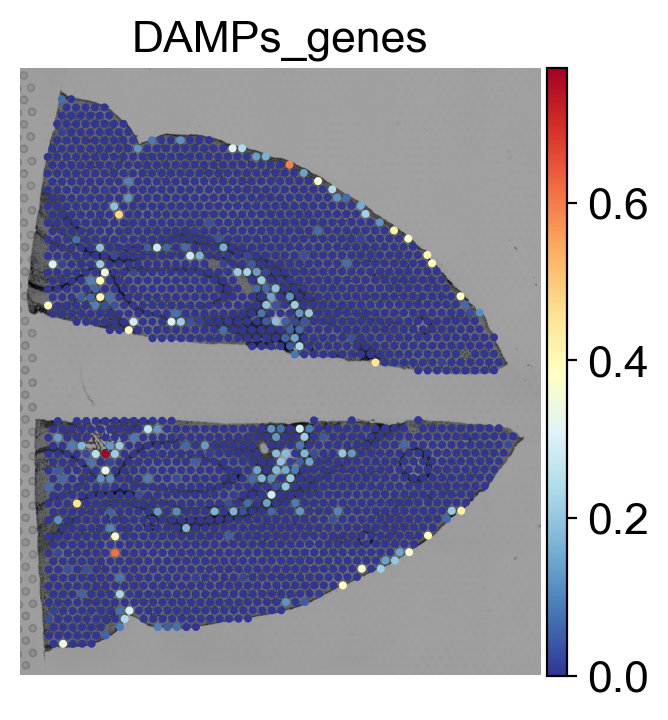

In [27]:
sc.pl.spatial(
    ad_int,
    img_key="hires",
    library_id='D_Intact',frameon= False,
    color=["DAMPs_genes"], cmap='RdYlBu_r',vmin=0, 
    size=1.3, save='_DAMPs_intact.pdf'
)

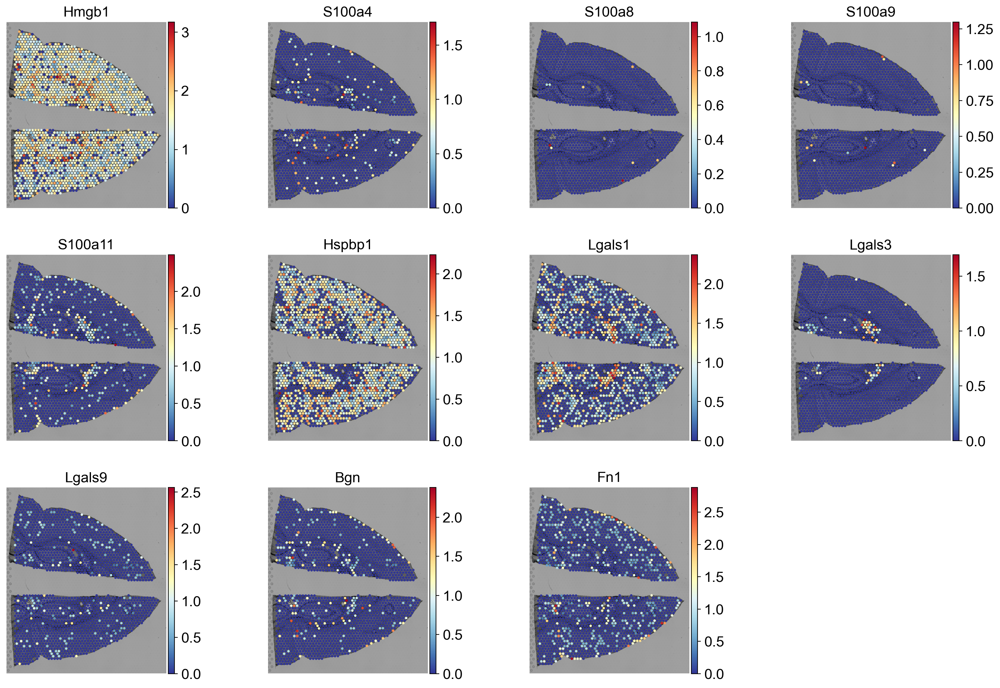

In [28]:
sc.pl.spatial(
    ad_int,
    img_key="hires",
    library_id='D_Intact',frameon= False,
    color=DAMPs_genes, cmap='RdYlBu_r',vmin=0, 
    size=1.3, save='_DAMPs_genes_intact.pdf'
)

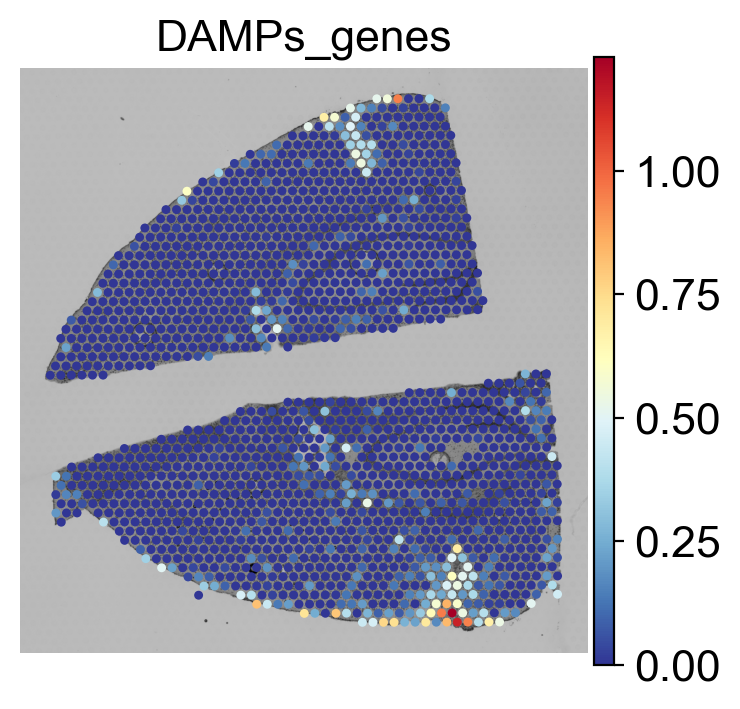

In [29]:
sc.pl.spatial(
    ad_3dpiV,
    img_key="hires",
    library_id='A_3dpi_V',frameon= False,
    color=['DAMPs_genes'], cmap='RdYlBu_r',vmin=0,
    size=1.3, save='_DAMPs_3dpi.pdf'
)

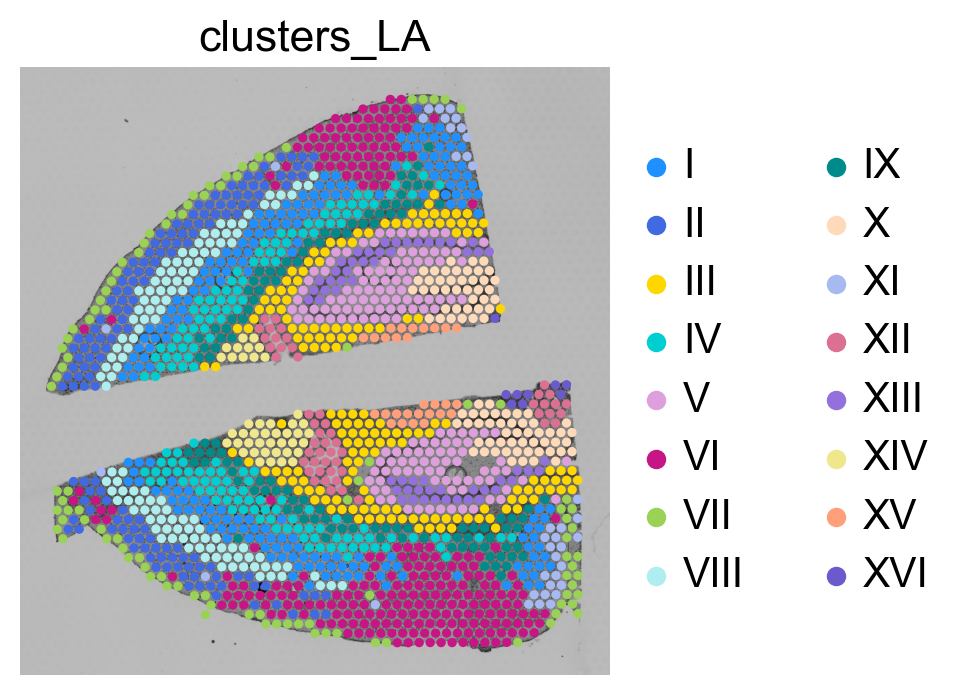

In [34]:
sc.pl.spatial(
    ad_3dpiV,
    img_key="hires",
    library_id='A_3dpi_V',frameon= False,
    color=['clusters_LA'], cmap='RdYlBu_r',vmin=0,
    size=1.3, 
)

In [38]:
ad_3dpiV_cortex = ad_3dpiV[np.in1d(ad_3dpiV.obs['clusters_LA'], 
                           ['I', 'II', 'IV', 'VI', 'VII', 'VIII','IX', 'XI'])].copy()

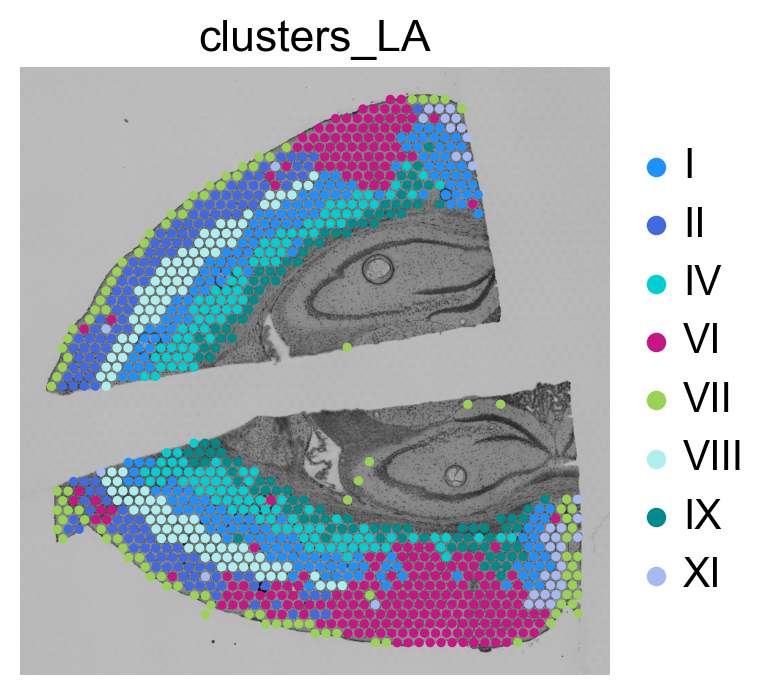

In [39]:
sc.pl.spatial(
    ad_3dpiV_cortex,
    img_key="hires",
    library_id='A_3dpi_V',frameon= False,
    color=['clusters_LA'], cmap='RdYlBu_r',vmin=0,
    size=1.3, 
)

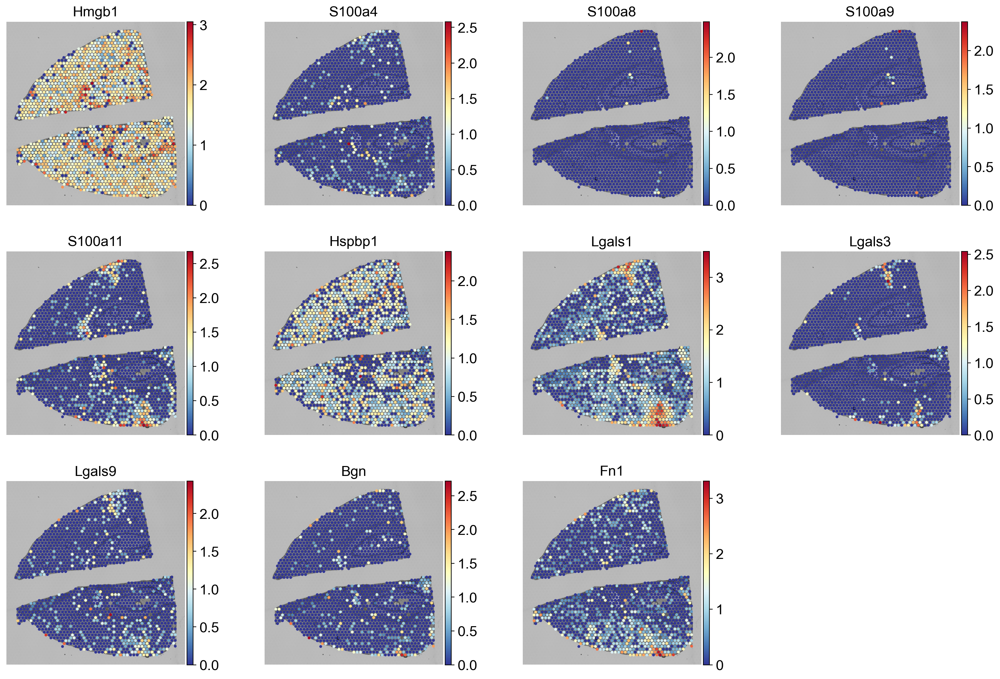

In [30]:
sc.pl.spatial(
    ad_3dpiV,
    img_key="hires",
    library_id='A_3dpi_V',frameon= False,
    color=DAMPs_genes, cmap='RdYlBu_r',vmin=0,
    size=1.3, save='_DAMPs_genes_3dpi.pdf'
)

In [42]:
sc.tl.dendrogram(ad_3dpiV_cortex, "clusters_LA")

    using 'X_pca' with n_pcs = 17
Storing dendrogram info using `.uns['dendrogram_clusters_LA']`


In [46]:
DAMPs_genes

['Hmgb1',
 'S100a4',
 'S100a8',
 'S100a9',
 'S100a11',
 'Hspbp1',
 'Lgals1',
 'Lgals3',
 'Lgals9',
 'Bgn',
 'Fn1']

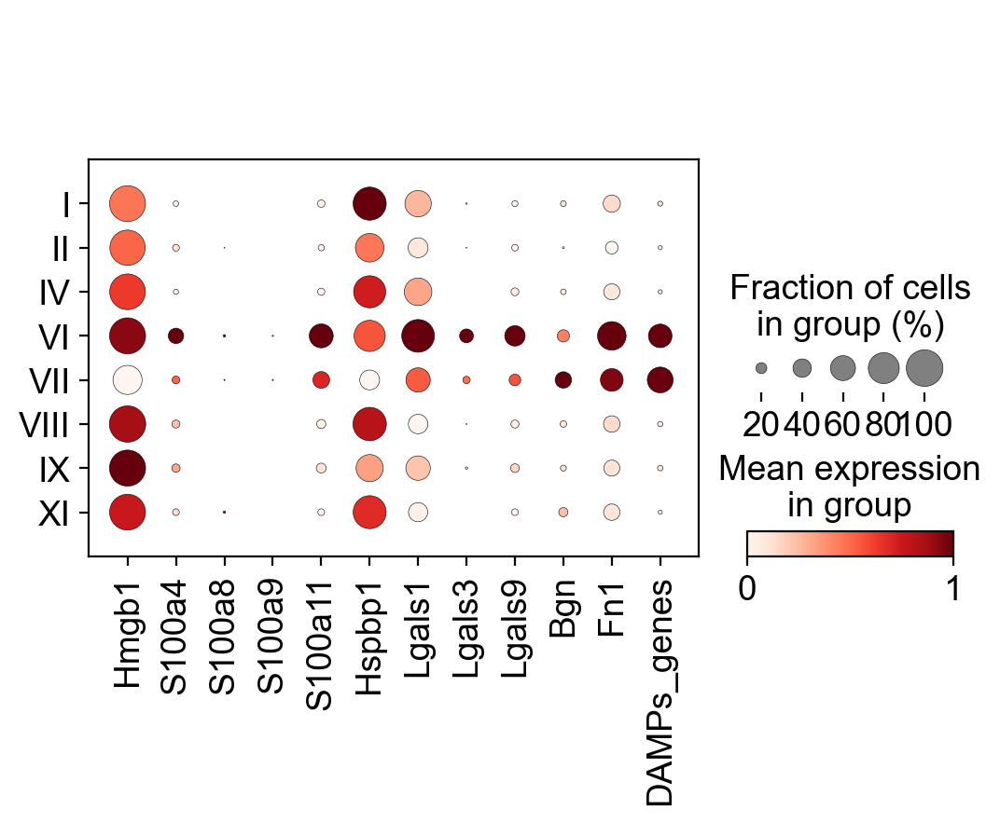

In [49]:
sc.pl.dotplot(ad_3dpiV_cortex,var_names=['Hmgb1',
 'S100a4',
 'S100a8',
 'S100a9',
 'S100a11',
 'Hspbp1',
 'Lgals1',
 'Lgals3',
 'Lgals9',
 'Bgn',
 'Fn1', 'DAMPs_genes'], groupby="clusters_LA", standard_scale='var', dendrogram=False, save='damps_cortex.pdf')

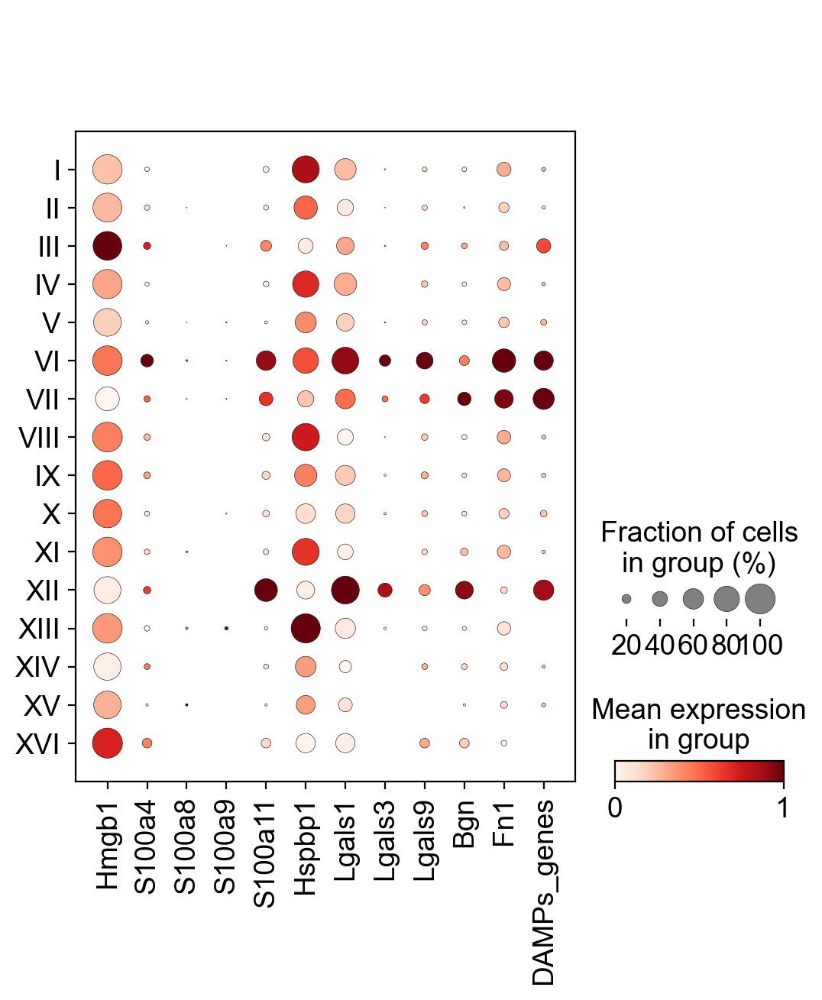

In [48]:
sc.pl.dotplot(ad_3dpiV,var_names=['Hmgb1',
 'S100a4',
 'S100a8',
 'S100a9',
 'S100a11',
 'Hspbp1',
 'Lgals1',
 'Lgals3',
 'Lgals9',
 'Bgn',
 'Fn1', 'DAMPs_genes'], groupby="clusters_LA", standard_scale='var')

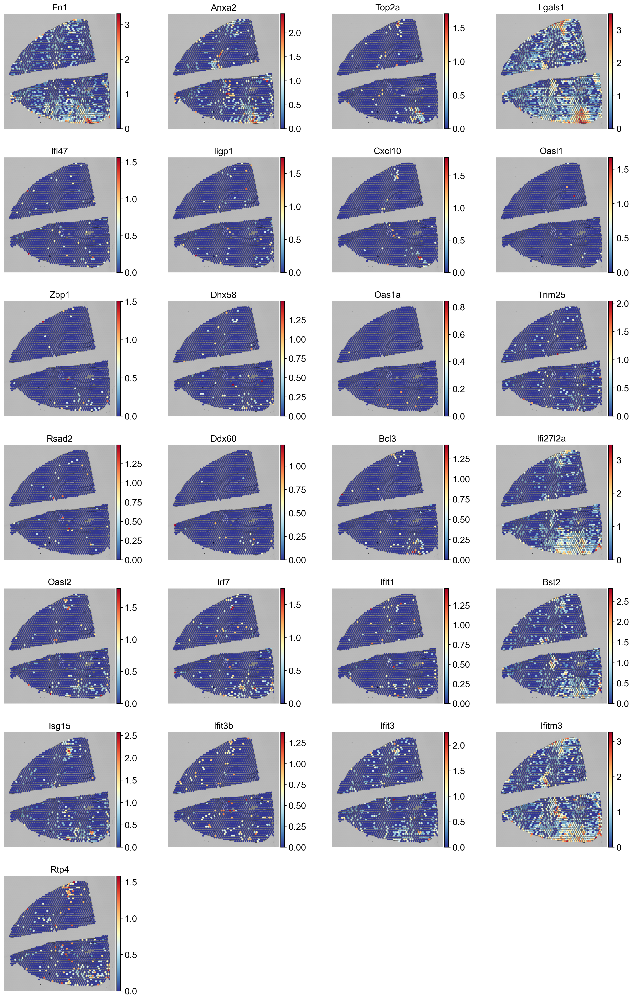

In [21]:
sc.pl.spatial(
    ad_3dpiV,
    img_key="hires",
    library_id='A_3dpi_V',frameon= False,
    color=['Fn1', 'Anxa2', 'Top2a', 'Lgals1', 'Ifi47', 'Iigp1', 'Cxcl10', 'Oasl1',
           'Zbp1', 'Dhx58', 'Oas1a', 'Trim25', 'Rsad2', 'Ddx60', 'Bcl3', 'Ifi27l2a', 'Oasl2', 'Irf7',
           'Ifit1', 'Bst2', 'Isg15', 'Ifit3b', 'Ifit3','Ifitm3','Rtp4'], cmap='RdYlBu_r',vmin=0,
    size=1.3
)

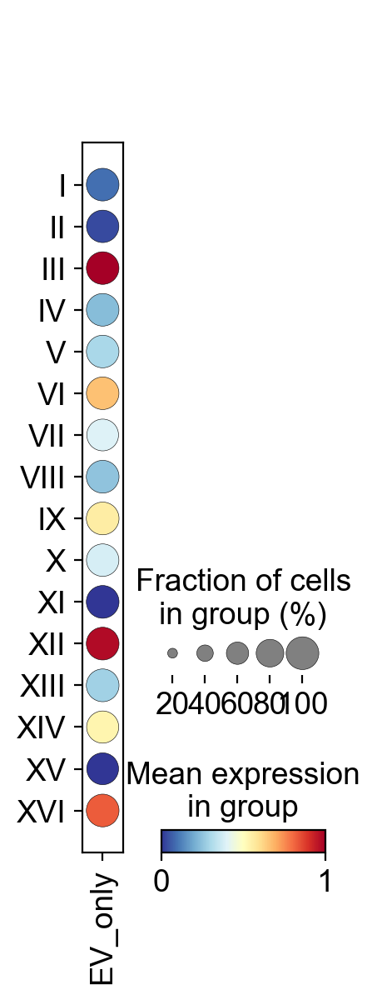

In [36]:
sc.pl.dotplot(
    ad_3dpiV,
  var_names= ['EV_only'], groupby='clusters_LA', cmap='RdYlBu_r',standard_scale='var',#save='EV_vs_Lysosome_3dpi_variable.png'
)

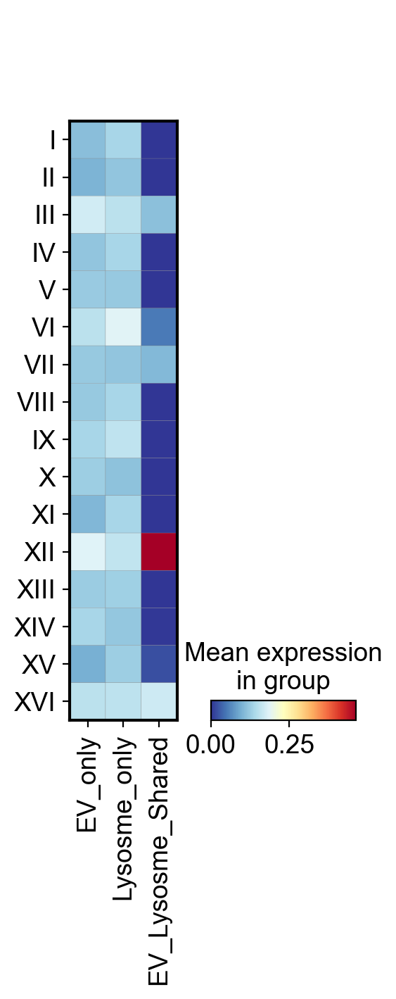

In [45]:
sc.pl.matrixplot(
    adata,
  var_names= ['EV_only','Lysosme_only','EV_Lysosme_Shared'], groupby='clusters_LA', cmap='RdYlBu_r',vmin=0
)

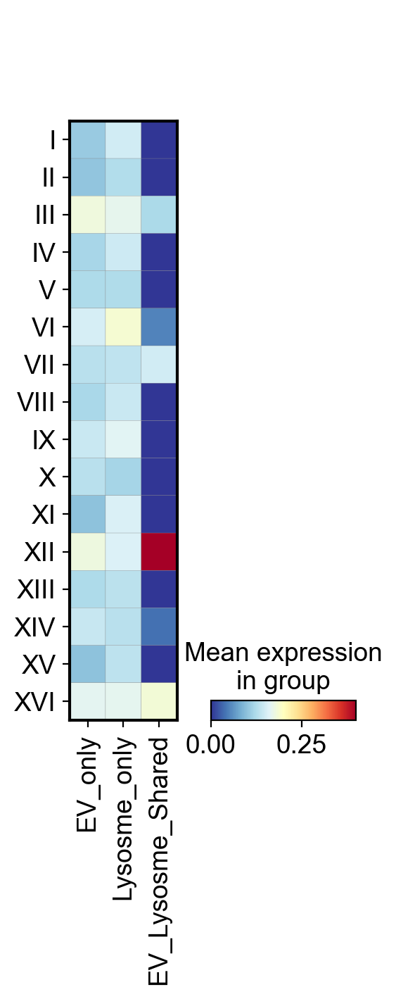

In [44]:
sc.pl.matrixplot(
    ad_3dpiV,
  var_names= ['EV_only','Lysosme_only','EV_Lysosme_Shared'], groupby='clusters_LA', vmax=0.4,cmap='RdYlBu_r', vmin=0
)

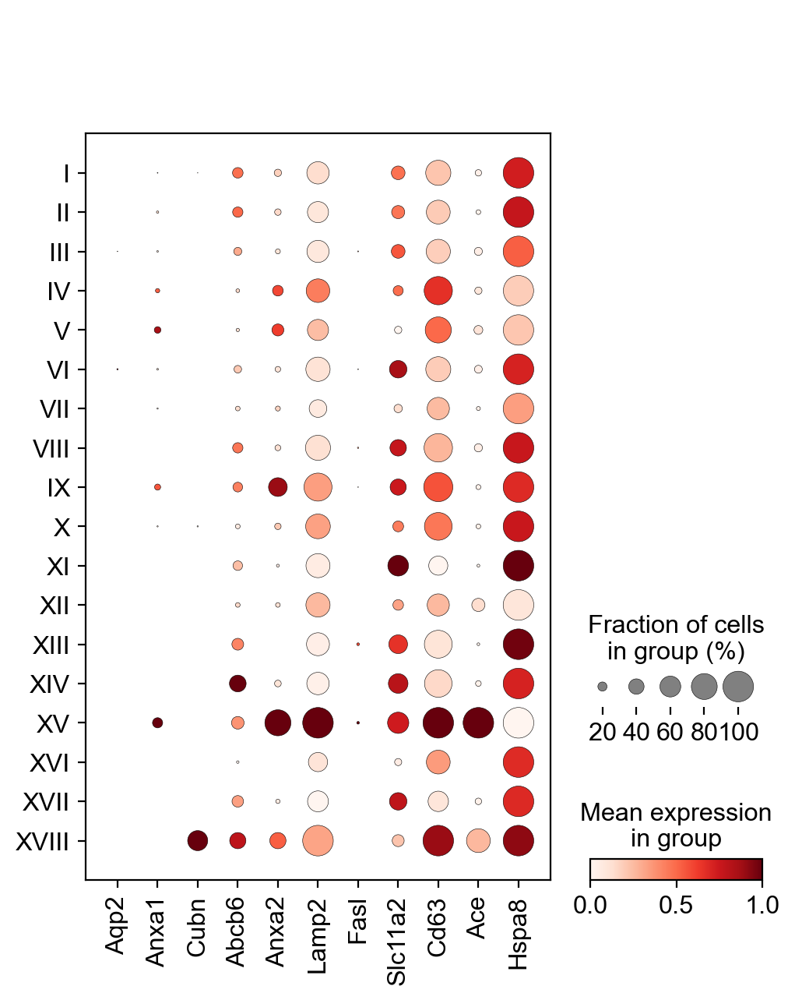

<IPython.core.display.Javascript object>

In [46]:
sc.pl.dotplot(
    ad_3dpiV, 
   EV_Lysosme_Shared, groupby='clusters_LA',standard_scale='var',
)

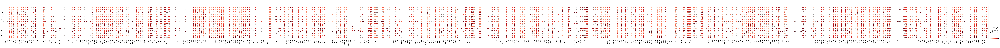

<IPython.core.display.Javascript object>

In [45]:
sc.pl.dotplot(
    ad_3dpiV, 
   Lysosme_only, groupby='clusters_LA',standard_scale='var',
)

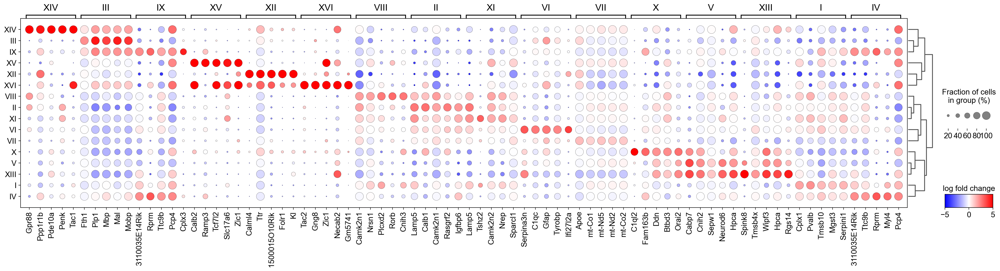

In [15]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, key='rank_genes_clusters_LA',figsize=(30,6), dendrogram=True,values_to_plot='logfoldchanges',
                               vmin=-5, vmax=5, cmap='bwr',)# save='_rank_genes.png'  )

In [16]:
result = adata.uns['rank_genes_clusters_LA']
groups = result['names'].dtype.names
adata_visium_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [17]:
adata_visium_genes

,I_n,I_s,I_p,I_l,II_n,II_s,II_p,II_l,III_n,III_s,...,XIV_p,XIV_l,XV_n,XV_s,XV_p,XV_l,XVI_n,XVI_s,XVI_p,XVI_l
0,Cplx1,28.680788,1.885553e-124,1.759826,Lamp5,30.612902,4.319861e-130,2.630501,Fth1,65.601723,...,2.836590e-73,5.569834,Calb2,25.157480,2.802402e-48,6.181034,Tac2,31.528862,7.483147e-42,8.227567
1,Pvalb,24.610516,1.845924e-106,2.157617,Calb1,29.711735,9.139415e-134,2.788588,Plp1,52.790665,...,4.647476e-70,4.636432,Ramp3,21.805182,1.099199e-41,4.917708,Gng8,26.956335,8.029224e-34,7.971217
2,Tmsb10,21.091055,1.799852e-78,1.360578,Camk2n1,29.354500,1.146365e-111,1.763572,Mbp,52.285503,...,3.904423e-62,5.289446,Tcf7l2,20.360956,7.642793e-35,5.874944,Zic1,26.951744,6.275393e-43,6.421702
3,Mgst3,20.091963,8.693529e-74,1.167374,Rasgrf2,26.928846,5.016549e-117,2.577612,Mal,51.926952,...,1.165848e-61,5.636817,Slc17a6,18.561922,3.022399e-35,4.620827,Necab2,25.708757,3.604613e-41,5.989905
4,Serpini1,19.937490,1.029857e-73,1.411910,Igfbp6,22.226074,2.227703e-86,1.999706,Mobp,50.817596,...,2.756503e-50,5.082491,Zic1,17.188524,2.688465e-32,5.209715,Gm5741,19.523024,2.539759e-23,9.604225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16300,Fth1,-12.494914,2.057698e-32,-0.501972,Trf,-18.824841,7.416854e-63,-2.630264,Scn1b,-25.902031,...,7.300238e-30,-3.885851,Psd,-10.909679,1.794450e-19,-3.131063,Ppp3ca,-10.900665,2.594981e-16,-2.596541
16301,Rplp1,-12.798424,6.544724e-35,-0.281629,Mobp,-19.794518,1.573122e-68,-2.346210,Slc12a5,-26.477634,...,9.778600e-34,-1.648764,Elmod1,-11.363153,1.296480e-19,-4.077806,Gng13,-11.045805,2.511143e-17,-3.320620
16302,S100a6,-13.201526,1.772631e-36,-1.699614,Plp1,-19.908615,5.000551e-69,-2.386382,Snap25,-26.941214,...,5.945007e-36,-2.750610,Atp1a1,-11.808883,3.255631e-21,-3.060510,Calm1,-12.386720,7.253541e-20,-1.733420
16303,Actb,-13.624099,8.407588e-39,-0.470848,Mbp,-21.030020,5.412960e-75,-1.959207,Atp2b2,-27.050564,...,3.389856e-35,-4.316952,Ctxn1,-13.066025,1.487691e-23,-3.783149,Slc1a2,-12.509556,9.405515e-21,-2.687576


In [18]:
#adata_visium_genes.to_csv(table_dir + 'adata_visium_genes.csv')

In [19]:
sc.set_figure_params(facecolor="white", figsize=(4, 10), dpi_save=300, dpi=150, fontsize=18)

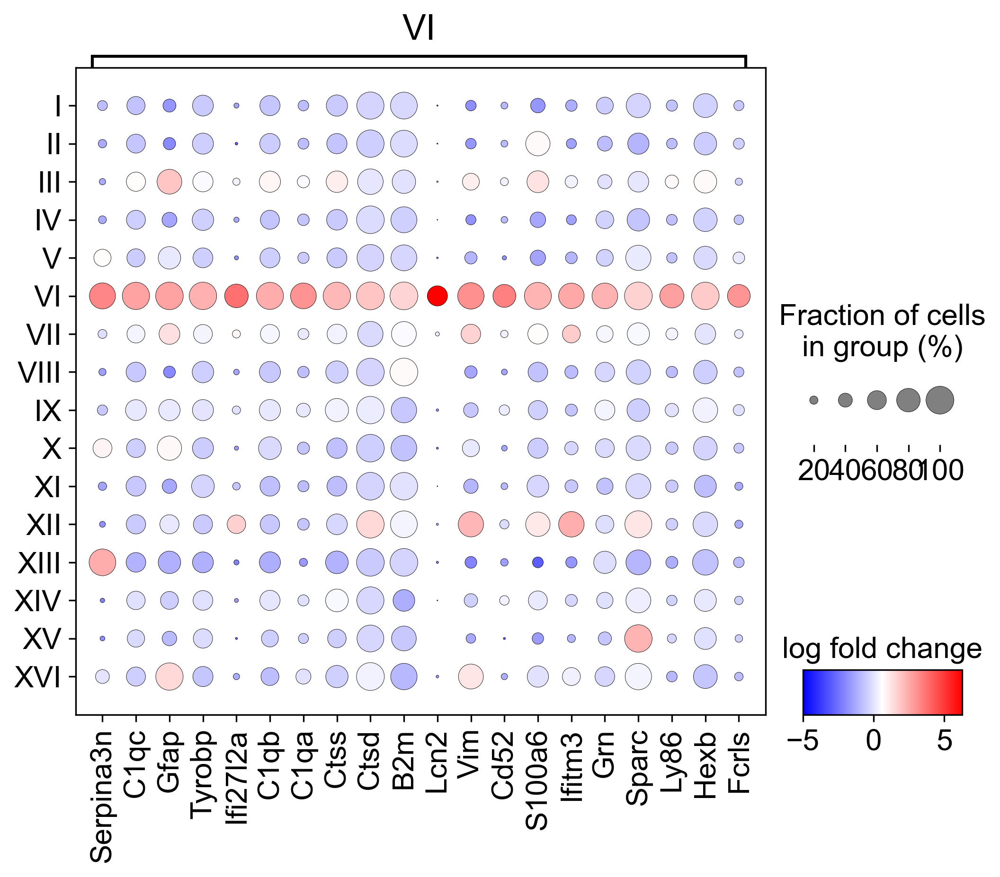

In [20]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata, n_genes=20,groups=['VI'], key='rank_genes_clusters_LA',values_to_plot='logfoldchanges',figsize=(8,6), dendrogram=False,
                                min_logfoldchange=1, vmin=-5, cmap='bwr',)#save='clVI.png' )

In [21]:
clusterVI=sc.get.rank_genes_groups_df(adata,['VI'], key='rank_genes_clusters_LA', pval_cutoff=0.05, log2fc_min=1)

In [22]:
#clusterVI.to_csv(table_dir + 'visium_clusterIV.csv')

In [23]:
#pd.DataFrame(adata.var_names).to_csv(table_dir + 'visium_background.csv')

In [24]:
visium_cl=['#1E90FF',#I
'#006399',#II
'#FFD700',#III
'#00CED1',#IV
'#DDA0DD',#V
'#C71585',#VI
'#8ac926',#VII
'#AFEEEE',#VIII
'#669999',#IX
'#FFDAB9',#X
'#a7b9f1',#XI
'#DB7093',#XII
'#9370DB',#XIII
'#F0E68C',#XIV      
'#FFA07A',#XV
'#6A5ACD',#XVI
'#D2691E',#XVII
'#BC8F8F'#XVIII
]

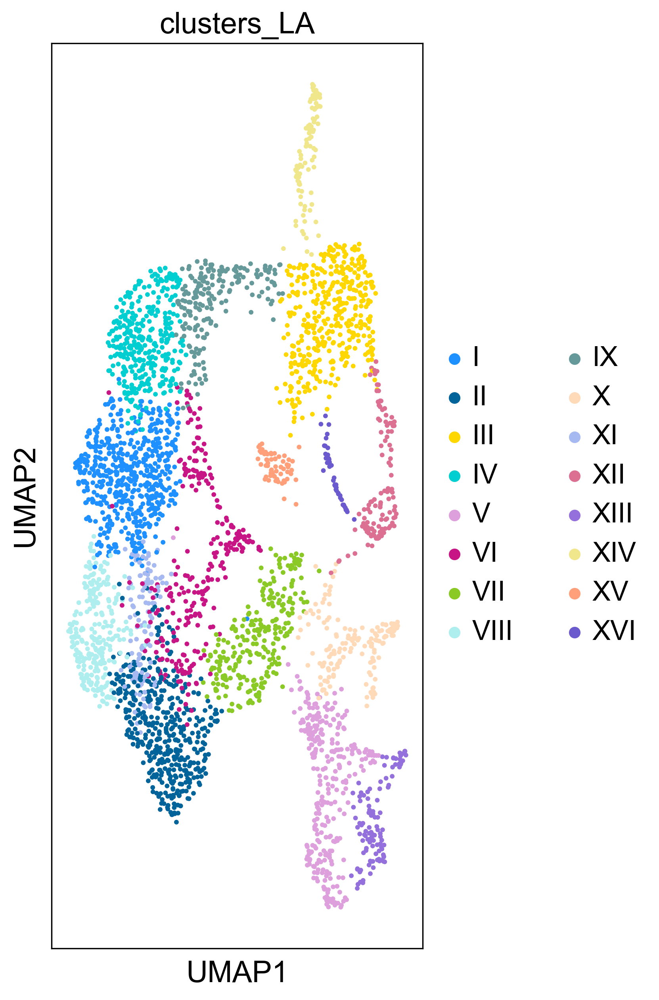

In [25]:
sc.pl.umap(
    adata, color=['clusters_LA'],  wspace=0.4, palette=visium_cl#save='visium_clustering.png'
)

In [26]:
ad_int=adata[adata.obs.library_id == 'D_Intact', :].copy()

In [27]:
ad_3dpiV=adata[adata.obs.library_id == 'A_3dpi_V', :].copy()

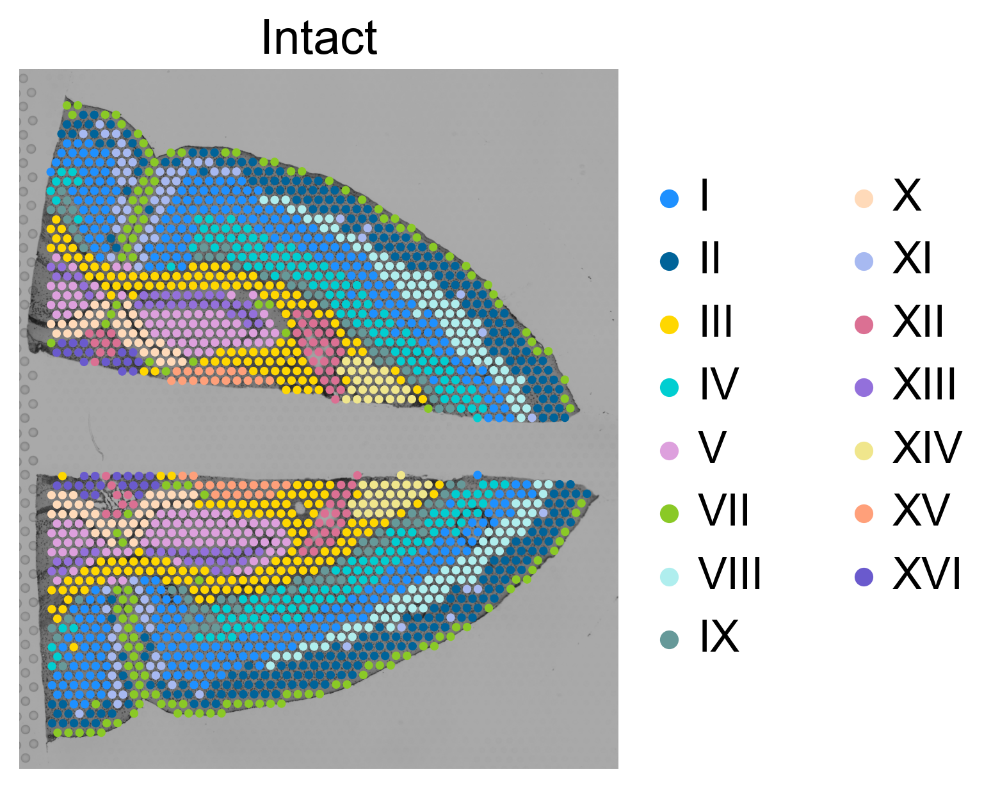

In [28]:
sc.pl.spatial(
        ad_int,
        img_key="hires",
        color=["clusters_LA", ],
    library_id='D_Intact', 
   frameon= False ,alpha_img=0.9,
 title=[ 'Intact',], wspace=0.3,vmin=0,vmax=0.3,
    cmap='RdYlBu_r',
        size=1.2,#save='clusternames_intact.png'
    )

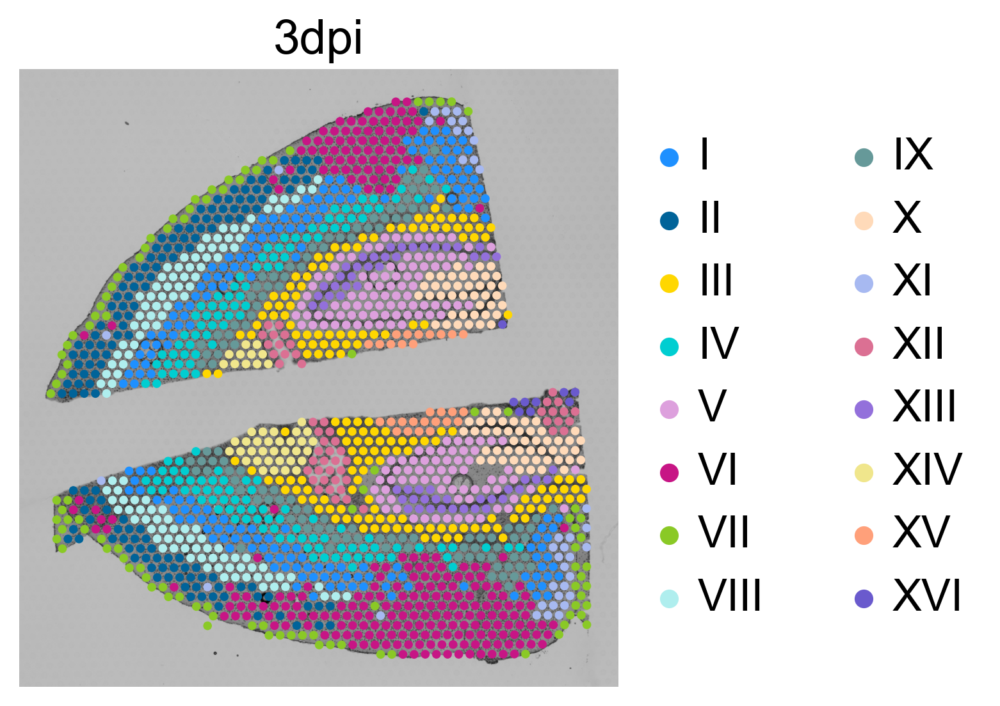

In [29]:
sc.pl.spatial(
        ad_3dpiV,
        img_key="hires",
        color=["clusters_LA", ],
    library_id='A_3dpi_V' ,
 title=[ '3dpi',], frameon= False, 
        size=1.2,#save='clusternames_3dpi.png'
    )

In [30]:
sc.set_figure_params(facecolor="white", figsize=(8, 8), dpi_save=300, dpi=70, fontsize=18)

In [31]:
ad_int_sub = ad_int[
    (ad_int.obsm["spatial"][:, 1] > 900)
    & (ad_int.obsm["spatial"][:, 1] < 4300)
    & (ad_int.obsm["spatial"][:, 0] < 5500)
    & (ad_int.obsm["spatial"][:, 0] > 300),
    :,
]

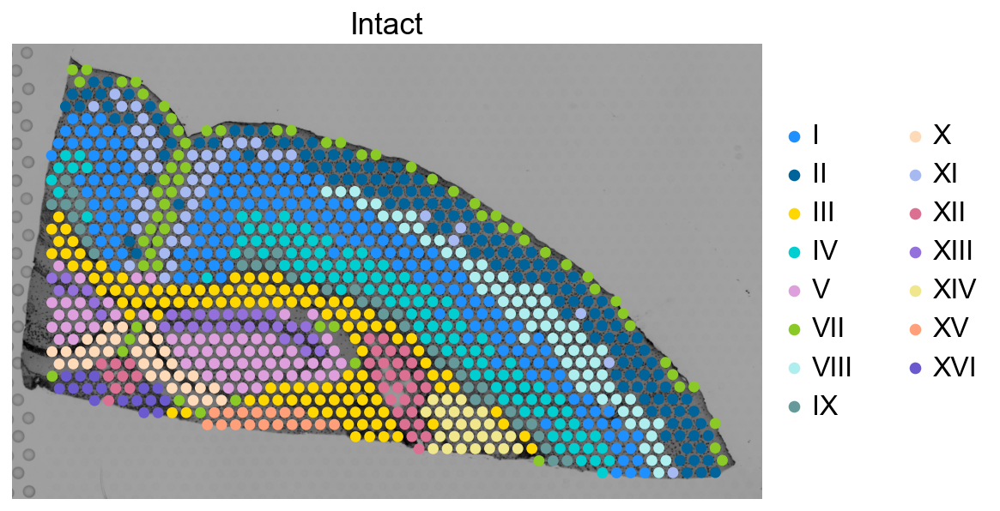

In [32]:
sc.pl.spatial(
        ad_int_sub,
        img_key="hires",
        color=["clusters_LA", ],
    library_id='D_Intact',
   frameon= False ,
 title=[ 'Intact',], wspace=0.3,vmin=0,vmax=0.3,
    cmap='RdYlBu_r', 
        size=1.2,#save='clusternames_intact_enrichedall.png'
    )

In [33]:
ad_3dpiV_sub = ad_3dpiV[
    (ad_3dpiV.obsm["spatial"][:, 1] > 900)
    & (ad_3dpiV.obsm["spatial"][:, 1] < 3700)
    & (ad_3dpiV.obsm["spatial"][:, 0] < 5800)
    & (ad_3dpiV.obsm["spatial"][:, 0] > 900),
    :,
]

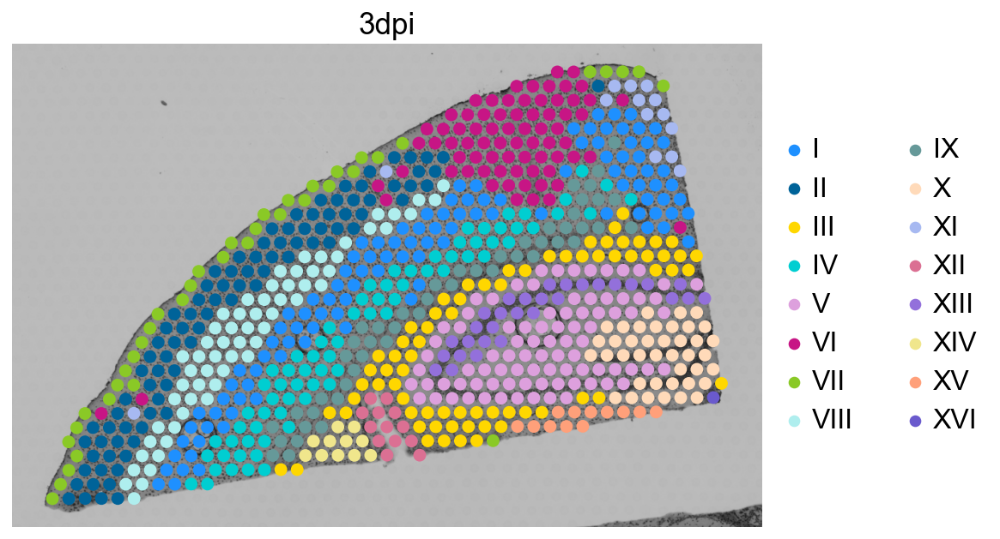

In [34]:
sc.pl.spatial(
        ad_3dpiV_sub,
        img_key="hires",
        color=["clusters_LA", ],
    library_id='A_3dpi_V',
   frameon= False ,
 title=[ '3dpi',], wspace=0.3, vmin=0, vmax=0.3,
        size=1.2,#save='clusternames_3dpi_enrichedall_sub.png'
    )

In [35]:
adata_st_down = ad_3dpiV[
    (ad_3dpiV.obsm["spatial"][:, 1] > 3650),  
    :,
]

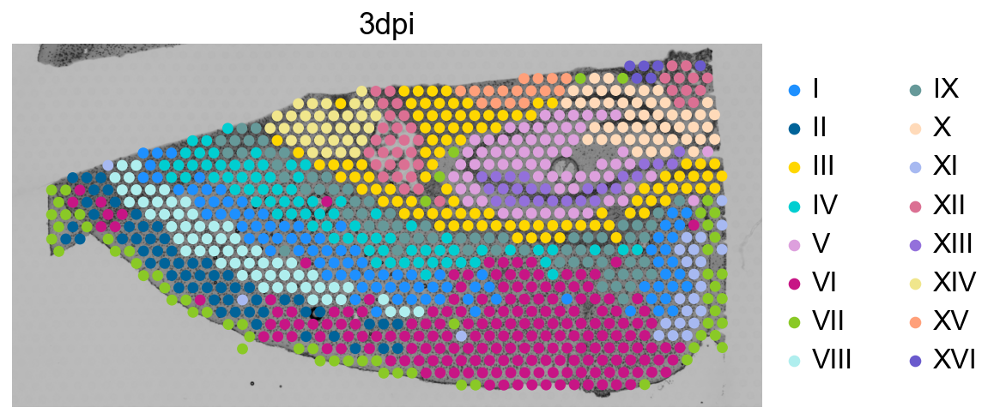

In [36]:
sc.pl.spatial(
        adata_st_down,
        img_key="hires",
        color=["clusters_LA", ],
    library_id='A_3dpi_V',
   frameon= False ,
 title=[ '3dpi',], wspace=0.3, vmin=0, vmax=0.3,
        size=1.2,#save='clusternames_3dpi_enrichedall_subd.png'
    )

### Neuronal layers Zeisel, A. et al 2018

In [37]:
sc.tl.score_genes(adata, [ 'Rprm','Rell1','Tbr1','3110035E14Rik','Nxph3', 'Hs3st4','Myl4', 'Cpne4', 'Fezf2', 'Tshz2', 'Lypd1'], score_name='Layer 6')

computing score 'Layer 6'
    finished: added
    'Layer 6', score of gene set (adata.obs).
    348 total control genes are used. (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


In [38]:
sc.tl.score_genes(adata, [ 'Cplx3', 'Nxph3', 'Hs3st4', 'Nr4a2', '3110035E14Rik'], score_name='Layer 6b')

computing score 'Layer 6b'
    finished: added
    'Layer 6b', score of gene set (adata.obs).
    249 total control genes are used. (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


In [39]:
sc.tl.score_genes(adata, [ 'Hs3st2', 'Vipr1', 'Pde1a', 'Scube1', 'Ml4', 'Dkkl1', 'Fezf2', 'RP24-134N2.1','Nov', 'Coro6', 'Lamp5', 'Kcng1'], score_name='Layer 5')

computing score 'Layer 5'
    finished: added
    'Layer 5', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


In [40]:
sc.tl.score_genes(adata, [ 'Krt12', 'Tcap', 'Dkkl1', 'Rorb', 'Tnnc1', 'A830036E02Rik'], score_name='Layer 4')

computing score 'Layer 4'
    finished: added
    'Layer 4', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


In [41]:
sc.tl.score_genes(adata, [ 'A830009L08Rik', 'Gm12371', 'Lamp5', 'Calb1', 'Igfbp6', 'A830009L08Rik'], score_name='Layer 2/3')

computing score 'Layer 2/3'
    finished: added
    'Layer 2/3', score of gene set (adata.obs).
    250 total control genes are used. (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


In [42]:
sc.tl.score_genes(adata, [ 'Tshz2', 'Ddit4l', 'Neurod6', 'Igfbp6', 'Dkk3', 'Kcns1'], score_name='Layer 2')

computing score 'Layer 2'
    finished: added
    'Layer 2', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)


/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


In [43]:
ad_int=adata[adata.obs.library_id == 'D_Intact', :].copy()

In [44]:
ad_3dpiV=adata[adata.obs.library_id == 'A_3dpi_V', :].copy()

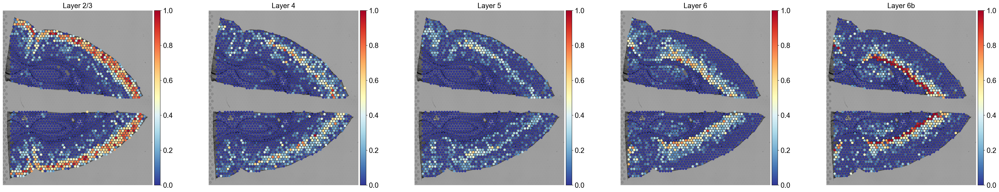

In [45]:
sc.pl.spatial(
    ad_int,
    img_key="hires",
    library_id='D_Intact',
    color=['Layer 2/3','Layer 4','Layer 5', 'Layer 6','Layer 6b',],frameon= False ,ncols=5,
    cmap='RdYlBu_r', legend_loc=None, vmin=0,vmax=1,
    size=1.3, #save='_layers_cortex.png'
)

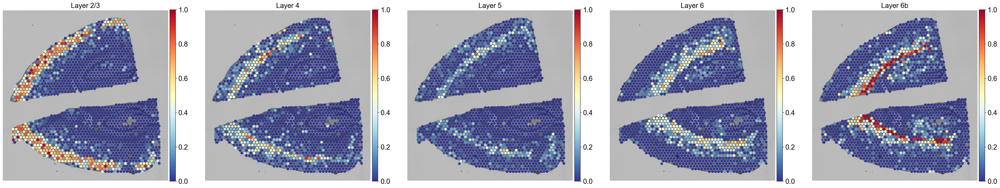

In [46]:
sc.pl.spatial(
    ad_3dpiV,
    img_key="hires",
    library_id='A_3dpi_V',
    color=['Layer 2/3','Layer 4','Layer 5', 'Layer 6','Layer 6b',],frameon= False ,ncols=5,
    cmap='RdYlBu_r', legend_loc=None, vmin=0,vmax=1,
    size=1.3, #save='_layers_cortex_inj.png'
)

#### Marker genes

In [47]:
sc.set_figure_params(facecolor="white", figsize=(10, 5), dpi_save=300, dpi=70, fontsize=18)

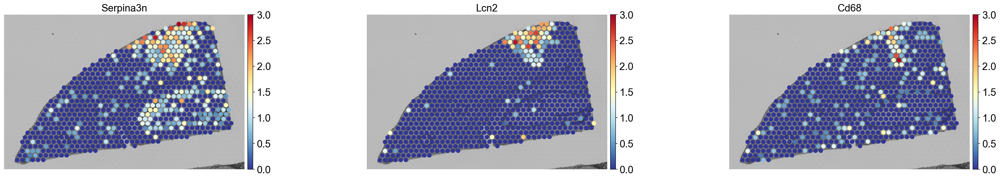

In [48]:
sc.pl.spatial(
    ad_3dpiV_sub,
    img_key="hires",
    library_id='A_3dpi_V',
    color=['Serpina3n','Lcn2','Cd68'],frameon= False , 
    cmap='RdYlBu_r', legend_loc=None, vmin=0, vmax=3,
    size=1.3,#save=('scope_intact.png')
)

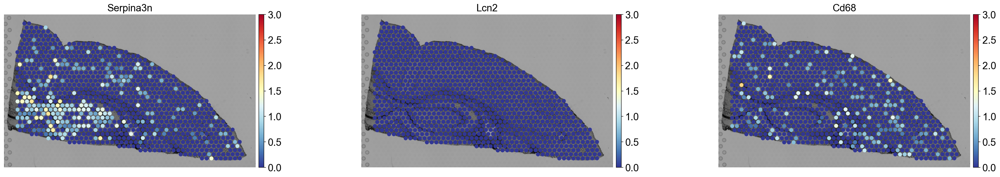

In [49]:
sc.pl.spatial(
    ad_int_sub,
    img_key="hires",
    library_id='D_Intact',
    color=['Serpina3n','Lcn2','Cd68'],frameon= False , 
    cmap='RdYlBu_r', legend_loc=None, vmin=0, vmax=3,
    size=1.3,#save=('scope_intact.png')
)

In [50]:
adata

AnnData object with n_obs × n_vars = 3710 × 16305
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters08', 'clusters1', 'clusters09', 'clusters_LA', 'S_score', 'G2M_score', 'phase', 'Layer 6', 'Layer 6b', 'Layer 5', 'Layer 4', 'Layer 2/3', 'Layer 2'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters08_colors', 'clusters09_colors', 'clusters1_colors', 'clusters_LA_colors', 'dendrogram_clusters08', 'dendrogram_clusters_LA', 'hvg', 'leiden', 'library_id_colors', 'log1p', 'neighbors'